# **Image Classifier**

In [ ]:
import tensorflow as tf

In [ ]:
# Other Imports
import tensorflow_hub as hub 
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
# Classifier URL from Tensorflow HUB 
classifier_url = "https://tfhub.dev/google/tf2-preview/mobilenet_v2/classification/4" 
IMAGE_SHAPE = (224, 224)

In [ ]:
# Creat a Model 
classifier = tf.keras.Sequential([
                                  
            hub.KerasLayer(classifier_url, input_shape= IMAGE_SHAPE+(3,))
])

In [ ]:
# Set up Images. 

image1 = '/content/bulck_cart.jpg'
image2 = '/content/flower.jpg'
image3 = '/content/swordweapon.jpg'
image4 = '/content/tiger.jpg'
image5 = '/content/tree.jpg'

In [ ]:
# Load Images and Reshape to 224X224 Required bye the Model 

import PIL.Image as Image
image1 = tf.keras.utils.get_file(image1,  "/content/bulck_cart.jpg")
image1 = Image.open(image1).resize(IMAGE_SHAPE)
# scale the array
image1 = np.array(image1)/255.0

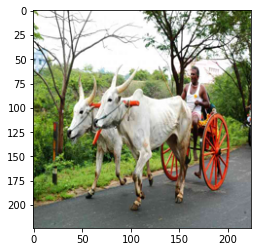

In [ ]:
plt.imshow(image1)

In [ ]:
image2 = tf.keras.utils.get_file(image2, '/content/flower.jpg')
image2 = Image.open(image2).resize(IMAGE_SHAPE)
image2 = np.array(image2)/255.0

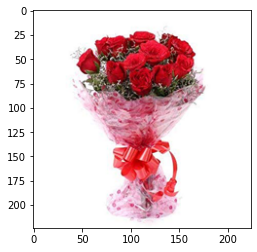

In [ ]:
plt.imshow(image2)

In [ ]:
image3 = tf.keras.utils.get_file(image3, '/content/swordweapon.jpg')
image3 = Image.open(image3).resize(IMAGE_SHAPE)
image3 = np.array(image3)/255.0

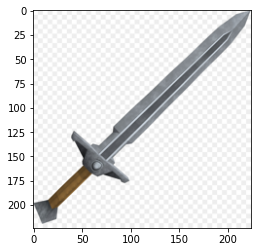

In [ ]:
plt.imshow(image3)

In [ ]:
image4 = tf.keras.utils.get_file(image4, '/content/tiger.jpg')
image4 = Image.open(image4).resize(IMAGE_SHAPE)
image4 = np.array(image4)/255.0

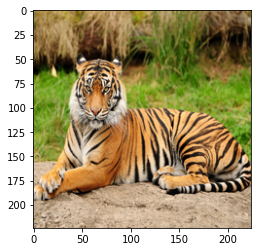

In [ ]:
plt.imshow(image4)

In [ ]:
image5 = tf.keras.utils.get_file(image5, '/content/tree.jpg')
image5 = Image.open(image5).resize(IMAGE_SHAPE)
image5 = np.array(image5)/255.0

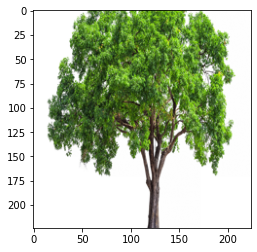

In [ ]:
plt.imshow(image5)

In [ ]:
# infer first image
result = classifier.predict(image1[np.newaxis, ...])
result.shape

(1, 1001)

In [ ]:
result

array([[ 0.27574435, -0.45772845,  0.48041314, ..., -0.88136786,
         0.46831256, -0.30661452]], dtype=float32)

In [ ]:
# array is in ascending order. so, pick up the bottom most prediction
predicted_class = np.argmax(result[0], axis=-1)

In [ ]:
predicted_class

691

In [ ]:
# Load Labels 
labels_path = tf.keras.utils.get_file('ImageNetLabels.txt','https://storage.googleapis.com/download.tensorflow.org/data/ImageNetLabels.txt')
imagenet_labels = np.array(open(labels_path).read().splitlines())

16384/10484 [==============================================] - 0s 0us/step


In [ ]:
labels_path

'/root/.keras/datasets/ImageNetLabels.txt'

In [ ]:
print(imagenet_labels)
print("Number of labels : ", len(imagenet_labels))

['background' 'tench' 'goldfish' ... 'bolete' 'ear' 'toilet tissue']
Number of labels :  1001


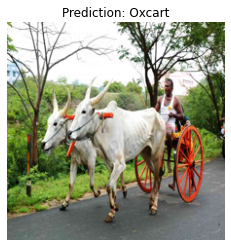

In [ ]:
# Show image and classification
plt.imshow(image1)
plt.axis('off')
predicted_class_name = imagenet_labels[predicted_class]
_ = plt.title("Prediction: " + predicted_class_name.title())

## Predict and Display Function

In [ ]:
def predict_display_image(imagex):
  result = classifier.predict(imagex[np.newaxis, ...])
  predicted_class = np.argmax(result[0], axis=-1)
  plt.imshow(imagex)
  plt.axis('off')
  print(predicted_class)
  predicted_class_name = imagenet_labels[predicted_class]
  _ = plt.title("Prediction : " + predicted_class_name.title())

552


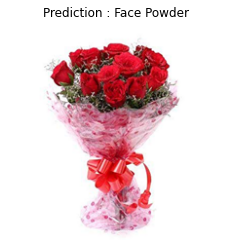

In [ ]:
# Predict and Print Results for Image 2
predict_display_image(image2)

624


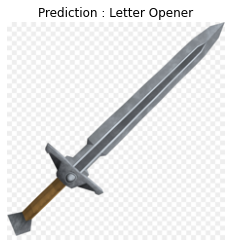

In [ ]:
# Predict and Print Results for Image 3
predict_display_image(image3)

293


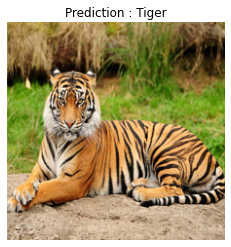

In [ ]:
# Predict and Print Results for Image 4
predict_display_image(image4)

739


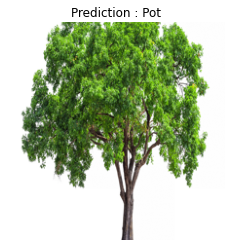

In [ ]:
# Predict and Print Results for Image 5
predict_display_image(image5)

In [ ]:
# Printe Entire List Categories
for i in range(len(imagenet_labels)):
  print(imagenet_labels[i])

background
tench
goldfish
great white shark
tiger shark
hammerhead
electric ray
stingray
cock
hen
ostrich
brambling
goldfinch
house finch
junco
indigo bunting
robin
bulbul
jay
magpie
chickadee
water ouzel
kite
bald eagle
vulture
great grey owl
European fire salamander
common newt
eft
spotted salamander
axolotl
bullfrog
tree frog
tailed frog
loggerhead
leatherback turtle
mud turtle
terrapin
box turtle
banded gecko
common iguana
American chameleon
whiptail
agama
frilled lizard
alligator lizard
Gila monster
green lizard
African chameleon
Komodo dragon
African crocodile
American alligator
triceratops
thunder snake
ringneck snake
hognose snake
green snake
king snake
garter snake
water snake
vine snake
night snake
boa constrictor
rock python
Indian cobra
green mamba
sea snake
horned viper
diamondback
sidewinder
trilobite
harvestman
scorpion
black and gold garden spider
barn spider
garden spider
black widow
tarantula
wolf spider
tick
centipede
black grouse
ptarmigan
ruffed grouse
prairie chic

# **Dog Breed Classifier**

In [1]:
import tensorflow as tf
import tensorflow_hub as hub

##**Loading Data** 

In [2]:
# WARNING - As the data file is large, a few checks are disabled
# during download. If in any DOUBTS, download data using your 
# own security measures 

!wget --no-check-certificate -r 'https://drive.google.com/uc?export=download&id=11t-eBwdXU9EWriDhyhFBuMqHYiQ4gdae' -O dogbreed

will be placed in the single file you specified.

--2021-02-07 01:32:42--  https://drive.google.com/uc?export=download&id=11t-eBwdXU9EWriDhyhFBuMqHYiQ4gdae
Resolving drive.google.com (drive.google.com)... 74.125.142.113, 74.125.142.138, 74.125.142.139, ...
Connecting to drive.google.com (drive.google.com)|74.125.142.113|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/html]
Saving to: ‘dogbreed’

dogbreed                [ <=>                ]   3.18K  --.-KB/s    in 0s      

2021-02-07 01:32:42 (40.3 MB/s) - ‘dogbreed’ saved [3259]

Loading robots.txt; please ignore errors.
--2021-02-07 01:32:42--  https://drive.google.com/robots.txt
Reusing existing connection to drive.google.com:443.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/plain]
Saving to: ‘dogbreed’

dogbreed                [ <=>                ]     570  --.-KB/s    in 0s      

2021-02-07 01:32:42 (85.6 MB/s) - ‘dogbreed’ saved [570]

--2021-02-07 01:32:

In [3]:
# Extract file contents
!unzip dogbreed

Streaming output truncated to the last 5000 lines.
  inflating: train/83bc62b0fffa99a9c94ba0b67a5f7395.jpg  
  inflating: train/83bcff6b55ee179a7c123fa6103c377a.jpg  
  inflating: train/83be6d622ab74a5e7e08b53eb8fd566a.jpg  
  inflating: train/83c2d7419b0429b9fe953bc1b6cddbec.jpg  
  inflating: train/83cf7d7cd2a759a93e2ffd95bea9c6fb.jpg  
  inflating: train/83d405858f0931722ef21e8ac0adee4d.jpg  
  inflating: train/83d4125a4c3c7dc5956563276cb1cd74.jpg  
  inflating: train/83f0bb565b2186dbcc6a9d009cb26ff2.jpg  
  inflating: train/83fad0718581a696132c96c166472627.jpg  
  inflating: train/83fbbcc9a612e3f712b1ba199da61f20.jpg  
  inflating: train/8403d8936430c2f05ab7d74d23c2c0cb.jpg  
  inflating: train/8406d837b2d7fac1c3cd621abb4c4f9e.jpg  
  inflating: train/840b67d26e5e43f8eb6430f62d4ba1ac.jpg  
  inflating: train/840db91ba4600148f3dcb06ec419b421.jpg  
  inflating: train/840dbad5a691c22611d85b2488bf4cbb.jpg  
  inflating: train/8410ced9ebc1759a7ebce5c42bfb5222.jpg  
  inflating: train/84

In [4]:
# Check the labels 
import pandas as pd
labels_csv = pd.read_csv('/content/labels.csv')
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [5]:
# Examine the table 
labels_csv.describe()

,id,breed
count,10222,10222
unique,10222,120
top,32d033e45db00bb90ce1b53589116de4,scottish_deerhound
freq,1,126


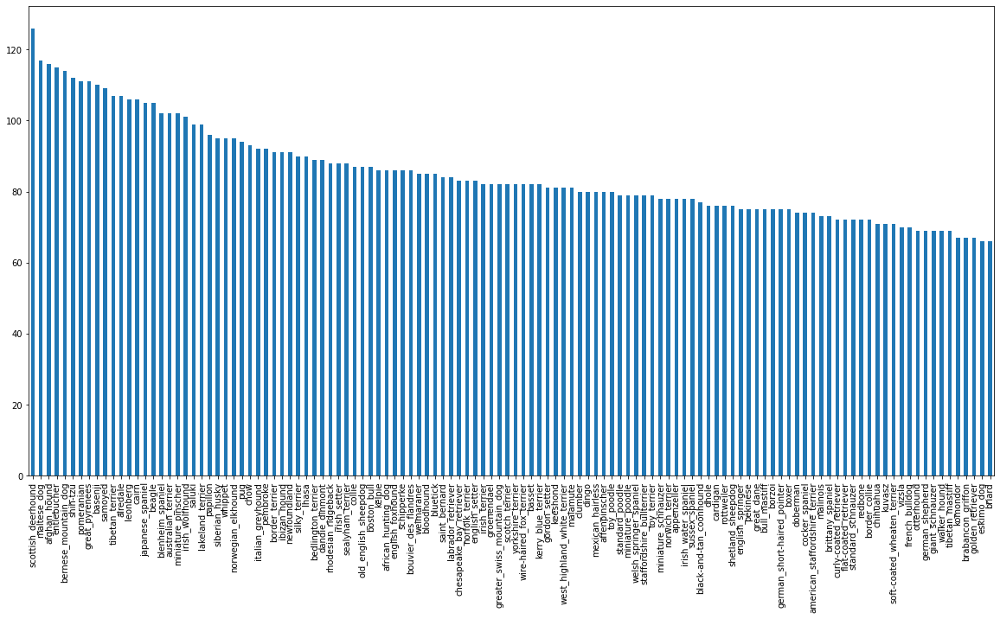

In [6]:
# How many images are there of each breed?
labels_csv['breed'].value_counts().plot.bar(figsize=(20, 10));

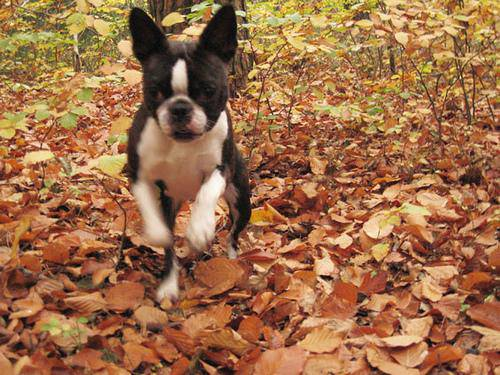

In [7]:
# Print sample image 
from IPython.display import display, Image
Image("/content/train/000bec180eb18c7604dcecc8fe0dba07.jpg")


## Setting up data paths

In [8]:
# Define our training file path for ease of use 
train_path = "/content/train"

In [9]:
# Create pathnames from image ID's
filenames = [train_path + '/'+fname+ ".jpg" for fname in labels_csv["id"]]

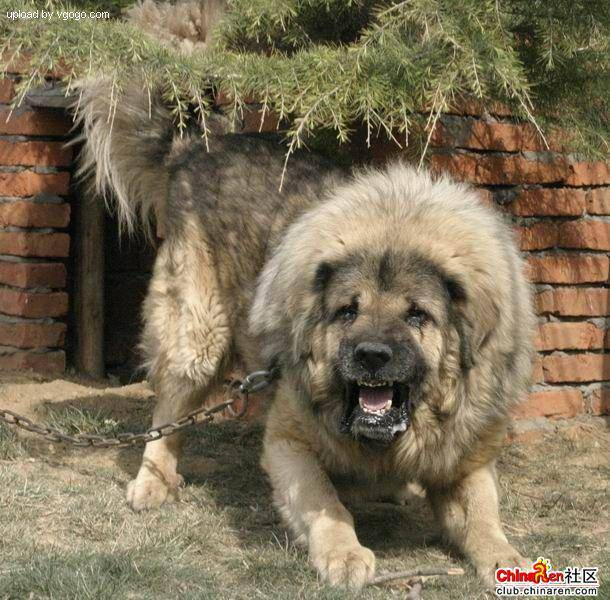

In [10]:
# Check an image directly from a filepath 
Image(filenames[9000])

In [11]:
# Extract unique labels 
import numpy as np
labels = labels_csv["breed"].to_numpy()
unique_breeds = np.unique(labels)
len(unique_breeds)

120

In [12]:
# print categories 
list(unique_breeds)

['affenpinscher',
 'afghan_hound',
 'african_hunting_dog',
 'airedale',
 'american_staffordshire_terrier',
 'appenzeller',
 'australian_terrier',
 'basenji',
 'basset',
 'beagle',
 'bedlington_terrier',
 'bernese_mountain_dog',
 'black-and-tan_coonhound',
 'blenheim_spaniel',
 'bloodhound',
 'bluetick',
 'border_collie',
 'border_terrier',
 'borzoi',
 'boston_bull',
 'bouvier_des_flandres',
 'boxer',
 'brabancon_griffon',
 'briard',
 'brittany_spaniel',
 'bull_mastiff',
 'cairn',
 'cardigan',
 'chesapeake_bay_retriever',
 'chihuahua',
 'chow',
 'clumber',
 'cocker_spaniel',
 'collie',
 'curly-coated_retriever',
 'dandie_dinmont',
 'dhole',
 'dingo',
 'doberman',
 'english_foxhound',
 'english_setter',
 'english_springer',
 'entlebucher',
 'eskimo_dog',
 'flat-coated_retriever',
 'french_bulldog',
 'german_shepherd',
 'german_short-haired_pointer',
 'giant_schnauzer',
 'golden_retriever',
 'gordon_setter',
 'great_dane',
 'great_pyrenees',
 'greater_swiss_mountain_dog',
 'groenendael',


In [13]:
# Encode target labels with values between 0 and 120
from sklearn.preprocessing import LabelEncoder
labels = LabelEncoder().fit_transform(labels).reshape(-1, 1)
labels

array([[19],
       [37],
       [85],
       ...,
       [ 3],
       [75],
       [28]])

In [14]:
# Use onehotencoding to convert categorical values 
from sklearn.preprocessing import OneHotEncoder 
boolean_labels = OneHotEncoder().fit_transform(labels).toarray()

In [15]:
boolean_labels[5]

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0.])

In [16]:
# Setup variables for features and labels 
X = filenames 
y = boolean_labels

In [17]:
# Create training/validation datasets
from sklearn.model_selection import train_test_split


# Split them into training and validation 
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

## Preprocessing Images

In [18]:
# Define image size 
IMG_SIZE = 224

def process_image(image_path):

  """
    Takes an image file path and turns it into a Tensor
  """

  # Read image file 
  image = tf.io.read_file(image_path)

  # Turn the jpet image into numerical Tensor
  image = tf.image.decode_jpeg(image, channels=3)

  # Convert the color channel values from 0-255 values to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)

  # Resize the image to our desired size (244, 244)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])

  return image
  

In [19]:
# Create a simple function to return a tuple (image, label)
def get_image_label(image_path, label):
  """
    Takes an image file path name and the associated label
    processes the image and return a tuple of (image, label)
  
  """

  image = process_image(image_path)
  return image, label

## Creating Batches of Data

In [20]:
# Define the batch size, 32 is good default 
BATCH_SIZE = 32

# Create a function to turn data into batches 
def create_data_batches(x, y = None, batch_size=BATCH_SIZE, data_type=1):
  """
      Creates batches of data out of image (x) and label (y) pairs.
      Shuffles the data if it's training data but doesn't shuffle it
      if it's validation data.

      Also accepts test data as input (no labels).
  """
  # If the data is a dataset, we don't have labels 
  if data_type == 3:
    print("Creating test data batches ......")
    # only filepaths
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x)))
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  # If the data is a valid dataset, we don't need to shuffle it
  elif data_type == 2:
    print("Creating validation data batches ......")
    # filepaths # labels
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), tf.constant(y)))
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    # If the data is a training dataset, we shuffle it
    print("Creating training data batches .....")
    # Turn filepaths and labels into Tensors 
    # file paths, labels
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), tf.constant(y)))
    
    # Shuffling pathnames and labels from mapping image processor function
    # is faster than suffling images
    data = data.shuffle(buffer_size= len(x))

    # Create (image, label) updates
    # (this also turns the image path into a preprocessed image)
    data = data.map(get_image_label)

    # Turn the data into batches
    data_batch = data.batch(BATCH_SIZE)

  return data_batch


## Visualizing data batch

In [21]:
# Function for viewing images in a data batch
import matplotlib.pyplot as plt

def show_25_images(images, labels):
  """
    Displays 25 images from a data batch.
  """

  # Set up the figure 
  plt.figure(figsize=(10, 10))
  # Loop through 25 (for displaying 25 images)
  for i in range(25):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    # Display an image
    plt.imshow(images[i])

    # Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn grid lines off
    plt.axis("off")

# **Defining Model**

In [22]:
# Setup input shape to the model
# batch height, width, color channels
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3]

# Setup output shape of the model
# Number of unique labels 
OUTPUT_SHAPE = len(unique_breeds)

# Setup model URL from Tensorflow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

In [23]:
# Create a function which builds a Keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building the model with: ", MODEL_URL)

  # Setup the model layers
  model = tf.keras.Sequential([
            
            # Tensorflow Hub Layer
            hub.KerasLayer(MODEL_URL),
            # Output layer
            tf.keras.layers.Dense(units=OUTPUT_SHAPE, activation="softmax")
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(),
      optimizer=tf.keras.optimizers.Adam(), 
      metrics=['accuracy']
  )

  # Build the model
  model.build(INPUT_SHAPE)

  return model

## **Model Summary**

In [24]:
# Create a model and print its summary
model = create_model()
model.summary()

Building the model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1001)              5432713   
_________________________________________________________________
dense (Dense)                (None, 120)               120240    
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


## **Creating Datasets**

In [25]:
# Create training dataset Tensor 
train_data = create_data_batches(X_train, y_train)

Creating training data batches .....


In [26]:
# Create validation dataset Tensor
val_data = create_data_batches(X_val, y_val)

Creating training data batches .....


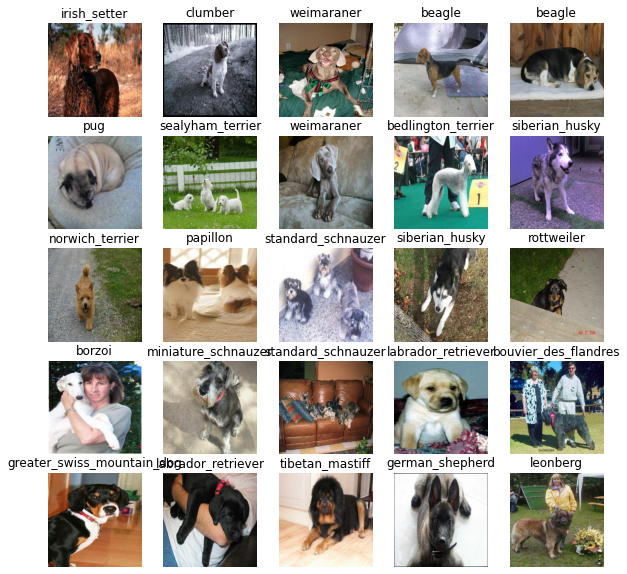

In [27]:
# Visualize training image from the training data batch
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

## **Setting up TensorBoard**

In [28]:
# Load the Tensorboard notebook extension 
%load_ext tensorboard

In [29]:
!rm -rf ./logs/ # cleaning the previous log

In [30]:
import datetime 
import os 


# Create function to build a Tensorboard callback 
def create_tensorboard_callback():
  # Create a log directory for storing Tensorboard logs 
  logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

In [31]:
# Tensorboard callback 
model_tensorboard = create_tensorboard_callback()

# Early stopping callback 
model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy", patience=3)

## **Model Training**

In [32]:
# Construct model 
model = create_model()

Building the model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [33]:
NUMBER_OF_EPOCHS = 100
model.fit(x=train_data, epochs=NUMBER_OF_EPOCHS, validation_data=val_data, callbacks=[model_tensorboard, model_early_stopping])

Epoch 1/100
256/256 [==============================] - 49s 154ms/step - loss: 2.6460 - accuracy: 0.4408 - val_loss: 0.7231 - val_accuracy: 0.7902
Epoch 2/100
256/256 [==============================] - 39s 152ms/step - loss: 0.4058 - accuracy: 0.8824 - val_loss: 0.6607 - val_accuracy: 0.8000
Epoch 3/100
256/256 [==============================] - 36s 140ms/step - loss: 0.2238 - accuracy: 0.9461 - val_loss: 0.6516 - val_accuracy: 0.8083
Epoch 4/100
256/256 [==============================] - 30s 117ms/step - loss: 0.1374 - accuracy: 0.9753 - val_loss: 0.6500 - val_accuracy: 0.8078
Epoch 5/100
256/256 [==============================] - 30s 117ms/step - loss: 0.0918 - accuracy: 0.9870 - val_loss: 0.6664 - val_accuracy: 0.8073
Epoch 6/100
256/256 [==============================] - 30s 117ms/step - loss: 0.0714 - accuracy: 0.9914 - val_loss: 0.6863 - val_accuracy: 0.8024
Epoch 7/100
256/256 [==============================] - 30s 117ms/step - loss: 0.0527 - accuracy: 0.9953 - val_loss: 0.6944 -

In [34]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

## **Evaluating Model Performance**

In [35]:
# Evaluate performance on validation data
model.evaluate(val_data)

64/64 [==============================] - 6s 97ms/step - loss: 0.7749 - accuracy: 0.8054


[0.7748802900314331, 0.8053789734840393]

## **Predicting Images in Test Data**

In [36]:
# Set up path to test images 
test_path = "/content/test"
test_filenames = [test_path +'/'+ fname for fname in os.listdir(test_path)]
# prepare test dataset 
test_data = create_data_batches(test_filenames, data_type=3)

Creating test data batches ......


In [37]:
# Make predictions on test data 
predictions = model.predict(test_data, verbose=1)

324/324 [==============================] - 31s 94ms/step


In [38]:
# Check how many images are tested?
predictions.shape

(10357, 120)

In [39]:
# Print the predictions for first image
predictions[0]

array([1.23667235e-06, 2.23665508e-09, 3.13209512e-07, 9.37501632e-10,
       4.60347765e-05, 4.54122109e-08, 1.79970048e-05, 2.37719883e-06,
       4.63720511e-08, 1.67010981e-07, 1.63529796e-06, 3.01978872e-07,
       1.17788230e-04, 3.38170603e-09, 1.43032119e-09, 4.76911111e-07,
       2.16036753e-07, 3.61918921e-08, 1.08484493e-08, 1.92463800e-09,
       2.86294044e-10, 4.79510820e-10, 2.02637445e-08, 1.94449100e-07,
       3.02204728e-09, 5.38599476e-09, 9.93842166e-03, 6.19608909e-06,
       2.54677102e-09, 6.99614759e-07, 5.75713045e-07, 6.65566660e-08,
       1.72266955e-05, 2.50161314e-08, 6.54087584e-09, 1.31086551e-03,
       5.89596061e-09, 2.34364819e-07, 6.34283097e-08, 1.36682603e-08,
       4.61109835e-08, 2.09933447e-07, 1.42566790e-07, 1.38384942e-10,
       6.88877150e-11, 2.83815498e-05, 2.40698501e-08, 9.14416542e-09,
       9.06075783e-08, 1.09205033e-07, 8.04564948e-08, 1.64704360e-07,
       2.73814482e-09, 3.02787022e-08, 1.51694355e-08, 4.32575682e-08,
      

In [40]:
# the max probability value predicted by the model 
print(f"Max value: {np.max(predictions[0])}")

Max value: 0.793626070022583


In [41]:
# the index where max value in predictions[0] occur
print(f"Max index: {np.argmax(predictions[0])}")

Max index: 116


In [42]:
# Predicted label 
print(f"Predicted label: {unique_breeds[np.argmax(predictions[0])]}")

Predicted label: west_highland_white_terrier


## **Visualizing Prediction Results**

In [43]:
# Function to plot image and the prediction
def plot_pred(prediction_probabilities, images):
  image = process_image(images)
  pred_label = unique_breeds[np.argmax(prediction_probabilities)]
  plt.imshow(image)
  plt.axis('off')
  plt.title(pred_label)

In [44]:
# function to print bar chart of predictions
def plot_pred_conf(prediction_probabilities):
  top_10_pred_indexes = prediction_probabilities.argsort()[-10:][::-1]
  top_10_pred_values = prediction_probabilities[top_10_pred_indexes]
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)), top_10_pred_values, color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)), labels=top_10_pred_labels, rotation='vertical')
  top_plot[0].set_color("green")

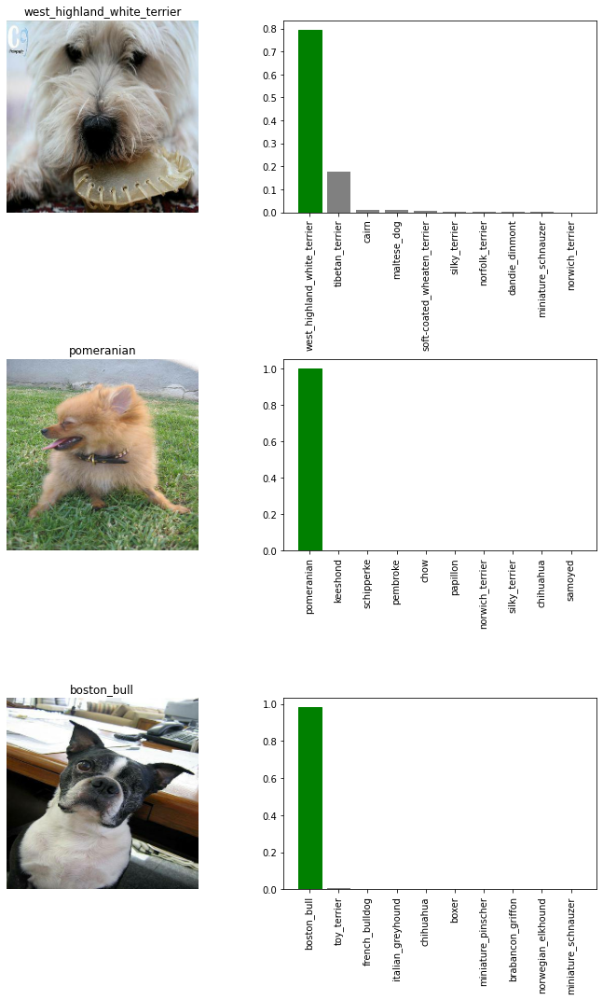

In [45]:
# Prin results for first three predictions
num_rows = 3
plt.figure(figsize=(5*2, 5* num_rows))
for i in range(num_rows):
  plt.subplot(num_rows, 2, 2*i+1)
  plot_pred(prediction_probabilities=predictions[i], images=test_filenames[i])
  plt.subplot(num_rows, 2, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions[i])
plt.tight_layout(h_pad=1.0)
plt.show()

## **Predicting Unseen Image**

In [46]:
# preprocess the image and convert it to Tensor
data=create_data_batches(['/content/tiger.jpg'],batch_size=1,data_type=3)

Creating test data batches ......


In [47]:
# infer the image
result = model.predict(data)

In [48]:
# get the prediction
predict_class_index = np.argmax(result[0],axis=-1)
predict_class_name = unique_breeds[(predict_class_index)] 

In [50]:
# get prediction probability
result_proba = model.predict_proba(data, batch_size=None)

/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/sequential.py:425: UserWarning: `model.predict_proba()` is deprecated and will be removed after 2021-01-01. Please use `model.predict()` instead.
  warnings.warn('`model.predict_proba()` is deprecated and '


In [51]:
# Check the threshold for prediction value 
if result_proba.max() > 0.7:
  print(pred_label)
else:
  print("Not a dog breed as the predicted probability is {}".format(result_proba.max()))

Not a dog breed as the predicted probability is 0.2521113455295563


## **Training with Smaller Datasets**

In [54]:
# array to hold the evaluation results
model_performance = []

# function for training the given model on specified
# number of images
def train_model(model, NUM_IMAGES):
  model.fit(x=train_data, epochs= NUMBER_OF_EPOCHS, validation_data=val_data, callbacks=[model_tensorboard, model_early_stopping])

In [56]:
# Training
NUMBER_OF_EPOCHS = 100
# Create models and test for 1000, 2000, 3000, 4000 images
for NUM_IMAGES in range(1000, 5000, 1000):
  model = create_model()
  x_train, x_val, y_train, y_val = train_test_split(X[:NUM_IMAGES], y[:NUM_IMAGES], test_size=0.2, random_state=10)
  train_data = create_data_batches(x_train, y_train, batch_size=10)
  val_data = create_data_batches(x_val, y_val, batch_size=10, data_type=2)
  train_model(model, NUM_IMAGES)
  model_performance.append(model.evaluate(val_data))

Building the model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Creating training data batches .....
Creating validation data batches ......
Epoch 1/100
25/25 [==============================] - 8s 189ms/step - loss: 5.1028 - accuracy: 0.0406 - val_loss: 3.5460 - val_accuracy: 0.1850
Epoch 2/100
25/25 [==============================] - 3s 135ms/step - loss: 1.9566 - accuracy: 0.6195 - val_loss: 2.2125 - val_accuracy: 0.4600
Epoch 3/100
25/25 [==============================] - 3s 135ms/step - loss: 0.5984 - accuracy: 0.9423 - val_loss: 1.6915 - val_accuracy: 0.5950
Epoch 4/100
25/25 [==============================] - 3s 137ms/step - loss: 0.2474 - accuracy: 0.9921 - val_loss: 1.5069 - val_accuracy: 0.6350
Epoch 5/100
25/25 [==============================] - 3s 138ms/step - loss: 0.1417 - accuracy: 0.9993 - val_loss: 1.4269 - val_accuracy: 0.6450
Epoch 6/100
25/25 [==============================] - 3s 137ms/step - loss: 0.1000 - accuracy: 1.0000 - val_los

In [58]:
model_performance

[[1.2964190244674683, 0.6800000071525574],
 [0.9317755103111267, 0.7325000166893005],
 [0.8236725330352783, 0.7699999809265137],
 [0.8112375736236572, 0.7699999809265137]]

In [60]:
# load the metrics in pandas and dataframe
import pandas as pd
comp = pd.DataFrame(model_performance, index=[1000, 2000, 3000, 4000], columns=['val_loss', 'val_acc'])

In [61]:
comp.head()

,val_loss,val_acc
1000,1.296419,0.6800
2000,0.931776,0.7325
3000,0.823673,0.7700
4000,0.811238,0.7700


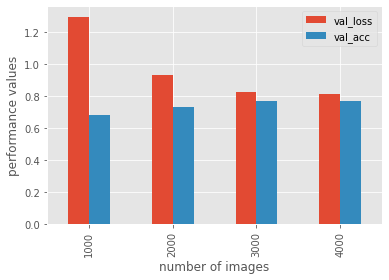

In [62]:
# plot the table 
import matplotlib.pyplot as plt 
plt.style.use('ggplot')
comp.plot.bar()
plt.xlabel('number of images')
plt.ylabel('performance values')
plt.show()

## **Saving and reloading a model**

In [63]:
# Saving model 
model.save('model.h5')

In [65]:
# Load the model 
from tensorflow.keras.models import load_model
model = load_model('model.h5', custom_objects={"KerasLayer":hub.KerasLayer})

In [66]:
# Summary of the model 
model.summary()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer_6 (KerasLayer)   (None, 1001)              5432713   
_________________________________________________________________
dense_6 (Dense)              (None, 120)               120240    
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________
